# <font color=green>deepBreaks Applications</font>
## Modeling spectral tuning sites of opsin proteins based on amino-acid sequence...  

In [1]:
from vpod_scripts.phylo_weighted_cv import get_dist_matrix_from_tree, percentile_threshold, phylo_weighted_cv

In [2]:
tree_file = "./opsin_wt_tree/vpod_1.1_wt/wt_aligned_VPOD_1.1_het.fasta.treefile"
dist_matrix, tip_names = get_dist_matrix_from_tree(tree_file)

In [3]:
percentile_dist_threshold = percentile_threshold(dist_matrix, percentile=5)
percentile_dist_threshold

0.2500477849

In [49]:
n_folds = 10 
tip_to_fold = phylo_weighted_cv(distance_matrix=dist_matrix, tip_names=tip_names, n_folds=n_folds, distance_threshold=percentile_dist_threshold, relation_mode='max_mean')

These are the average distances for each leaf:
[1.47838048 1.59276812 1.58001156 1.57565462 1.62380009 1.63366234
 1.62723773 1.565617   1.55847353 1.58156603 1.57194762 1.58922583
 1.55992539 1.55992558 1.57061779 1.56866668 1.55834862 1.57725233
 1.57725233 1.59037955 1.5776822  1.57446367 1.57745632 1.56422639
 1.54595232 1.55693051 1.59547863 1.60509471 1.56049055 1.55680686
 1.58477509 1.59443288 1.56219827 1.57115708 1.5785258  1.602344
 1.55977965 1.56374607 1.60230242 1.60575317 1.54388694 1.53716553
 1.55122954 1.54375086 1.54288659 1.52850831 1.54282693 1.54010289
 1.55863468 1.6204478  1.73701198 1.68944186 1.75145783 1.64089486
 1.74060322 1.68622603 1.75951281 1.7390181  1.5179832  1.60036838
 1.60036825 1.56770483 1.55446631 1.52350464 1.56758132 2.28959125
 2.20143836 2.26278001 2.27610192 2.17696327 1.50760985 1.55425617
 1.53933838 1.50410624 1.40190728 1.42689486 1.50975683 1.44584702
 1.5174925  1.65218625 1.37990045 1.35802569 1.46600022 1.63042629
 1.60575022 2.174

In [50]:
# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, get_simp_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
from deepBreaks.preprocessing import write_fasta
import warnings
import datetime
import os
import shutil 

In [51]:
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')

In [52]:
# defining user params, file pathes, analysis type

#assign your path to folder containing all the datasplits
path = './vpod_1.1_data_subsets_2024-05-02'
# path to sequences of interest
seqFileName = f'{path}/wt_aligned_VPOD_1.1_het.fasta' 
# path to corresponding metadata of interest
metaDataFileName = f'{path}/wt_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 

gap_threshold = 0.50

#Whether or not you want to drop the reference sequence from the training data- Usually 'Bovine' or 'Squid'
drop_ref = False


In [53]:
# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('/')[2]
#print(seqFile)
seqFile = seqFile.split('.')[0]
#print(seqFile)
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

direcory preparation


In [54]:
%%time
print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)
# importing sequences data
print('reading fasta file')

tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=gap_threshold)

shutil.copy2(f'{seqFileName}',report_dir)
write_fasta(dat = tr, fasta_file = f'{seqFile}_gap_dropped.fasta' , report_dir = report_dir)

reading meta-data
reading fasta file
wt_aligned_VPOD_1_gap_dropped.fasta was saved successfully
CPU times: total: 219 ms
Wall time: 219 ms


In [55]:
try:
    reference_seq = tr.loc['Bovine'].copy()
    ref_seq_name = 'bovine'
    if drop_ref == True:
        meta_data = meta_data.drop('Bovine')
    #print(bovine)
except:
    reference_seq = tr.loc['Squid'].copy()
    ref_seq_name = 'squid'
    #print(squid)
reference_seq.to_csv(path_or_buf= f'{report_dir}/ref_sequence.csv',index = True,mode="w")

In [56]:
tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

(362, 355)

In [57]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,Lambda_Max
Bovine,M,NaN,N,G,T,E,G,P,N,F,...,NaN,NaN,NaN,S,Q,V,A,P,A,500.0
S1,M,NaN,N,G,T,E,G,P,Y,F,...,S,A,NaN,S,S,V,S,P,A,502.0
S2,NaN,NaN,NaN,NaN,T,E,G,P,Y,F,...,S,A,NaN,S,S,V,S,P,A,502.0
S3,NaN,NaN,NaN,NaN,T,E,G,P,D,F,...,S,A,NaN,S,S,V,S,P,A,481.0
S4,NaN,NaN,NaN,NaN,T,E,G,P,F,F,...,S,A,NaN,S,S,V,S,P,A,494.0


In [58]:
tr = tr.reindex(tip_to_fold.index)

In [59]:
tr['Fold'] = tip_to_fold['Fold']

In [60]:
#test_data = tr[tr['Folds'] == -1]
#tr = tr[tr['Folds'] != -1]

In [61]:
#test_data.shape

In [62]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p347,p348,p349,p350,p351,p352,p353,p354,Lambda_Max,Fold
Tip_Names,,,,,,,,,,,,,,,,,,,,,
Bovine,M,NaN,N,G,T,E,G,P,N,F,...,NaN,NaN,S,Q,V,A,P,A,500.0,6
S1,M,NaN,N,G,T,E,G,P,Y,F,...,A,NaN,S,S,V,S,P,A,502.0,0
S2,NaN,NaN,NaN,NaN,T,E,G,P,Y,F,...,A,NaN,S,S,V,S,P,A,502.0,2
S4,NaN,NaN,NaN,NaN,T,E,G,P,F,F,...,A,NaN,S,S,V,S,P,A,494.0,7
S3,NaN,NaN,NaN,NaN,T,E,G,P,D,F,...,A,NaN,S,S,V,S,P,A,481.0,6


In [63]:
tr_phylo_folds = tr['Fold'].tolist()
tr.drop('Fold', axis=1, inplace=True)

In [64]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,Lambda_Max
Tip_Names,,,,,,,,,,,,,,,,,,,,,
Bovine,M,NaN,N,G,T,E,G,P,N,F,...,NaN,NaN,NaN,S,Q,V,A,P,A,500.0
S1,M,NaN,N,G,T,E,G,P,Y,F,...,S,A,NaN,S,S,V,S,P,A,502.0
S2,NaN,NaN,NaN,NaN,T,E,G,P,Y,F,...,S,A,NaN,S,S,V,S,P,A,502.0
S4,NaN,NaN,NaN,NaN,T,E,G,P,F,F,...,S,A,NaN,S,S,V,S,P,A,494.0
S3,NaN,NaN,NaN,NaN,T,E,G,P,D,F,...,S,A,NaN,S,S,V,S,P,A,481.0


In [65]:
import numpy as np
import csv
import pandas as pd

In [66]:
y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)

Shape of data is:  (362, 354)


**Attention**: metadata and sequences data should have the names as their row names and for each sequence their must be a value in the meta data file.

In [67]:
print('metadata looks like this:')
meta_data.head()

metadata looks like this:


,Lambda_Max,Species,Opsin_Family,Phylum,Class,Accession,Mutations
Bovine,500.0,Bos_tarus,Rh1,Chordata,Mammalia,NM_001014890,NaN
S1,502.0,Neoniphon_sammara,Rh1,Chordata,Actinopteri,U57536.1,NaN
S2,502.0,Neoniphon_argenteus,Rh1,Chordata,Actinopteri,U57540.1,NaN
S3,481.0,Neoniphon_aurolineatus,Rh1,Chordata,Actinopteri,U57541.1,NaN
S4,494.0,Sargocentron_punctatissimum,Rh1,Chordata,Actinopteri,U57543.1,NaN


In [68]:
print('sequence data looks like this:')
tr.head()

sequence data looks like this:


,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p345,p346,p347,p348,p349,p350,p351,p352,p353,p354
Tip_Names,,,,,,,,,,,,,,,,,,,,,
Bovine,M,NaN,N,G,T,E,G,P,N,F,...,NaN,NaN,NaN,NaN,S,Q,V,A,P,A
S1,M,NaN,N,G,T,E,G,P,Y,F,...,S,S,A,NaN,S,S,V,S,P,A
S2,NaN,NaN,NaN,NaN,T,E,G,P,Y,F,...,S,S,A,NaN,S,S,V,S,P,A
S4,NaN,NaN,NaN,NaN,T,E,G,P,F,F,...,S,S,A,NaN,S,S,V,S,P,A
S3,NaN,NaN,NaN,NaN,T,E,G,P,D,F,...,S,S,A,NaN,S,S,V,S,P,A


In [69]:
y_ev = 1239.8 / np.array(y)

### Preprocessing
In this step, we do all these steps:
1. dropping columns with a number of missing values above a certain threshold  
2. dropping zero entropy columns  
3. imputing missing values with the mode of that column  
4. replacing cases with a frequency below a threshold (default 1.5%) with the mode of that column
5. dropping zero entropy columns
6. use statistical tests (each position against the phenotype) and drop columns with p-values below a threshold (default 0.25)
7. one-hot encode the remaining columns
8. calculate the pair-wise distance matrix for all of the columns
9. use the distance matrix for DBSCAN and cluster the correlated positions together
10. keep only one column (closes to center of each cluster) for each group and drop the rest from the training data set

In [70]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.1, keep=False)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.01, keep=False))
    ])

In [71]:
%%time
report, top = model_compare_cv(X=tr, y=y, preprocess_pipe=prep_pipeline,
                               models_dict=get_models(ana_type=ana_type),
                               scoring=get_scores(ana_type=ana_type),
                               report_dir=report_dir,
                               cv=tr_phylo_folds, ana_type=ana_type, cache_dir=report_dir)

Fitting rf...
Fitting Adaboost...
Fitting et...
Fitting gbr...
Fitting dt...
Fitting lr...
Fitting Lasso...
Fitting LassoLars...
Fitting BayesianRidge...
Fitting HubR...
Fitting lgbm...
Fitting xgb...
CPU times: total: 7.06 s
Wall time: 50 s


MAE = Mean Absolute Error

MSE = Mean Squared Error

RMSE = Rooted Mean Square Error

MAPE = Mean Absolute % Error - the average magnitude of error produced by a model, or how far off predictions are on average. A MAPE value of 20% means that the average absolute percentage difference between the predictions and the actuals is 20%

In [72]:
report

,R2,MAE,MSE,RMSE,MAPE
xgb,9.319088e-01,8.153769e+00,2.337249e+02,1.439943e+01,1.731894e-02
BayesianRidge,9.138169e-01,9.257797e+00,2.970417e+02,1.593319e+01,2.007902e-02
lgbm,8.955759e-01,9.830534e+00,3.666357e+02,1.675722e+01,2.154435e-02
gbr,8.924812e-01,9.786508e+00,3.799945e+02,1.683093e+01,2.114776e-02
rf,8.816201e-01,9.866112e+00,4.165580e+02,1.760237e+01,2.158369e-02
et,8.749961e-01,9.486872e+00,4.320225e+02,1.856985e+01,2.035752e-02
dt,8.737343e-01,1.013815e+01,4.387759e+02,1.914302e+01,2.175937e-02
Adaboost,8.633215e-01,1.430171e+01,4.683391e+02,2.018925e+01,3.118701e-02
HubR,8.603569e-01,1.111864e+01,4.775893e+02,2.090702e+01,2.382582e-02
LassoLars,8.579306e-01,1.411776e+01,4.871941e+02,2.060890e+01,3.104514e-02


In [73]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.1, keep=True)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.01, keep=True))
    ])

In [74]:
modified_top = []
mtml = []
for model in top:
    modified_top.append(make_pipeline(steps=[('prep', prep_pipeline), model.steps[-1]]))
    my_top_models = str(model[1:])
    #print(my_top_models)
    my_top_models = my_top_models.split("'")[3]
    mtml.append(my_top_models)
    #print(my_top_models)

In [75]:
modified_top[0]

Pipeline(steps=[('prep',
                 Pipeline(steps=[('mc', MisCare(missing_threshold=0.05)),
                                 ('cc', ConstantCare()),
                                 ('ur', URareCare(threshold=0.025)),
                                 ('cc2', ConstantCare()),
                                 ('one_hot', CustomOneHotEncoder()),
                                 ('feature_selection',
                                  FeatureSelection(alpha=0.1, keep=True,
                                                   model_type='reg')),
                                 ('collinear_care',
                                  CollinearCare(dist_method='correlation',
                                                keep=True, threshold=0.0...
                              feature_types=None, gamma=None, gpu_id=None,
                              grow_policy=None, importance_type=None,
                              interaction_constraints=None, learning_rate=None,
                              max_bin=None, max_cat_threshold=None,
                              max_cat_to_onehot=None, max_delta_step=None,
                              max_depth=None, max_leaves=None,
                              min_child_weight=None, missing=nan,
                              monotone_constraints=None, n_estimators=100,
                              n_jobs=-1, num_parallel_tree=None, predictor=None,
                              random_state=123, ...))])

In [76]:
%%time
top = finalize_top(X=tr, y=y, top_models=modified_top, grid_param=get_simp_params(),report_dir=report_dir, cv=tr_phylo_folds)


Tuning xgb...
No Grid-Search Specified, fitting model to default parameters.
Tuning BayesianRidge...
Beginning Grid Search
Best Model R-squared:	0.9138169380132662
Tuning lgbm...
No Grid-Search Specified, fitting model to default parameters.
Tuning gbr...
No Grid-Search Specified, fitting model to default parameters.
Tuning rf...
Beginning Grid Search
Best Model R-squared:	0.9223505737855783
CPU times: total: 32.7 s
Wall time: 7min 20s


In [77]:
%%time
sr = summarize_results(top_models=top, report_dir=report_dir)

CPU times: total: 953 ms
Wall time: 943 ms


In [78]:
sr.head()

,feature,p_value,score,xgb,BayesianRidge,lgbm,gbr,rf,mean
0,p1_GAP,0.219579,1.512379,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
1,p1_M,0.012788,6.260621,0.000010,0.001779,0.107143,0.0,0.006100,0.023006
2,p2_DNHLVYP,0.070072,3.300942,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
3,p2_G,0.077795,3.128217,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
4,p2_GAP,0.000732,11.604172,0.000007,0.151840,0.107143,0.0,0.007339,0.053266


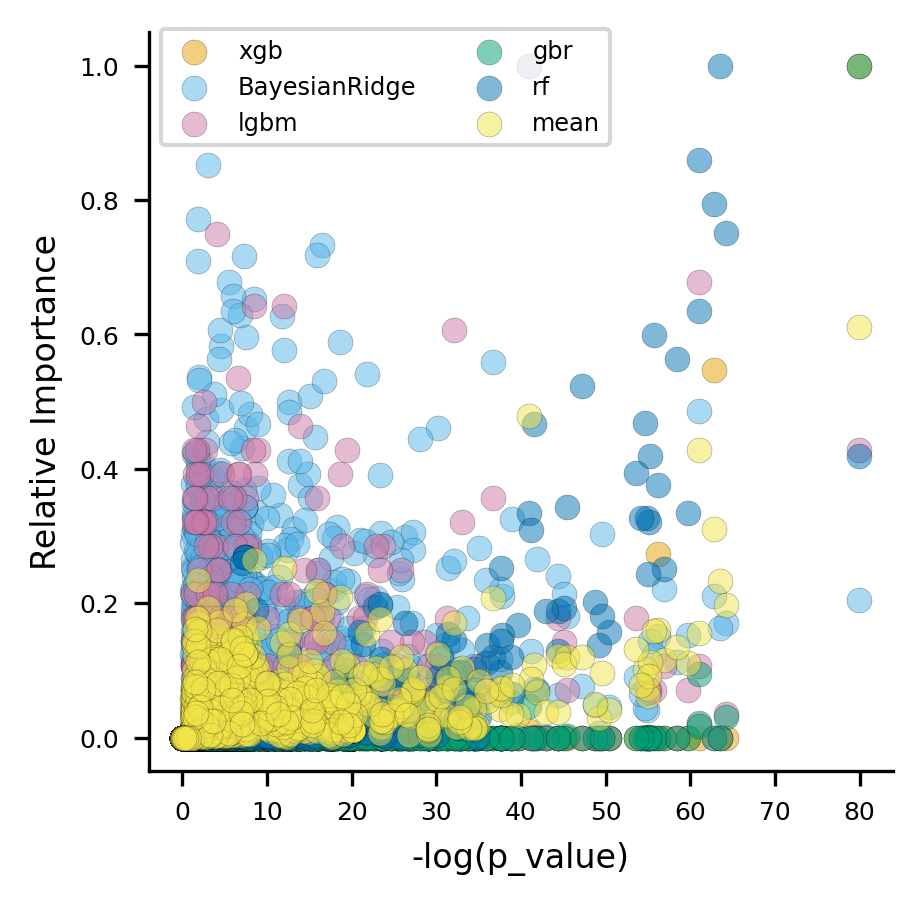

In [79]:
scatter_plot = plot_scatter(summary_result=sr, report_dir=report_dir)

In [80]:
%%time
mean_imp = mean_importance(top, report_dir=report_dir)

CPU times: total: 188 ms
Wall time: 164 ms


mean Done


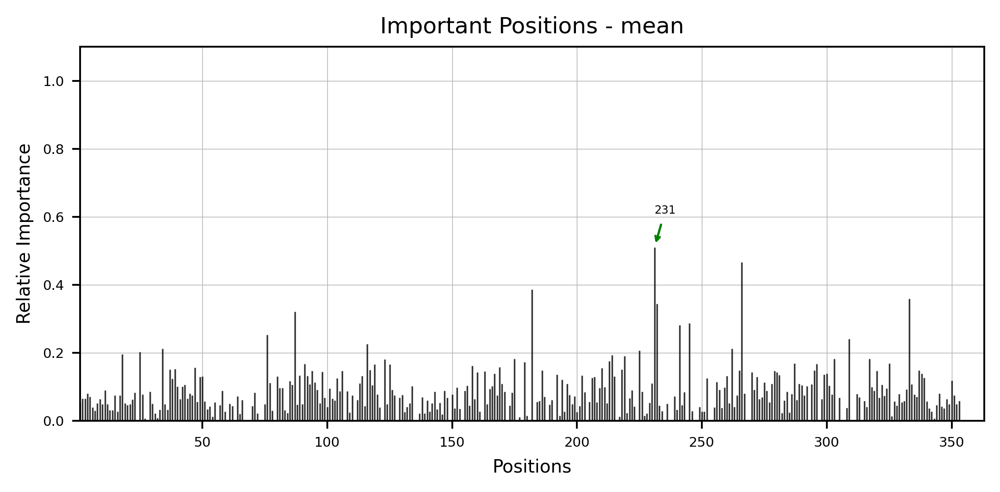

In [81]:
dp_plot(importance=mean_imp,imp_col='mean', model_name='mean', report_dir=report_dir)

In [82]:
tr = prep_pipeline[:4].fit_transform(tr)

xgb Done
xgb  Done
BayesianRidge Done
BayesianRidge  Done
lgbm Done
lgbm  Done
gbr Done
gbr  Done
rf Done
rf  Done


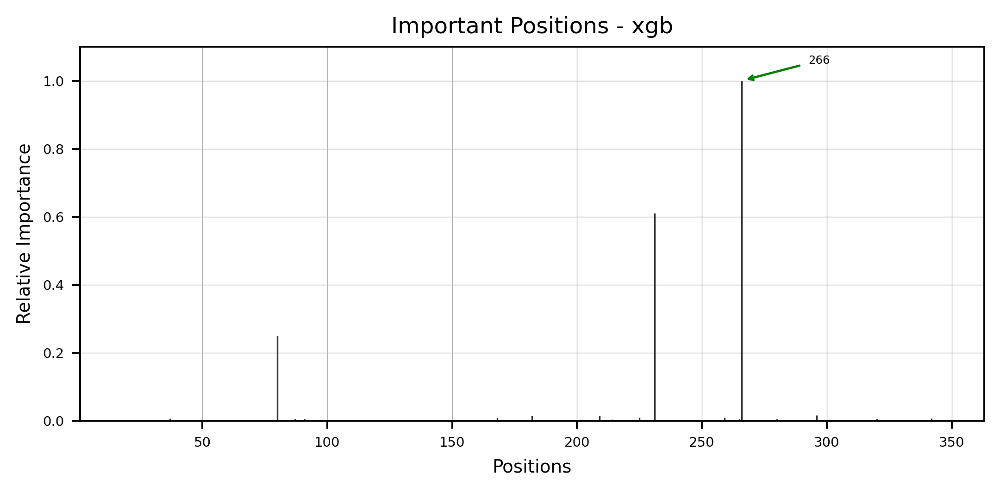

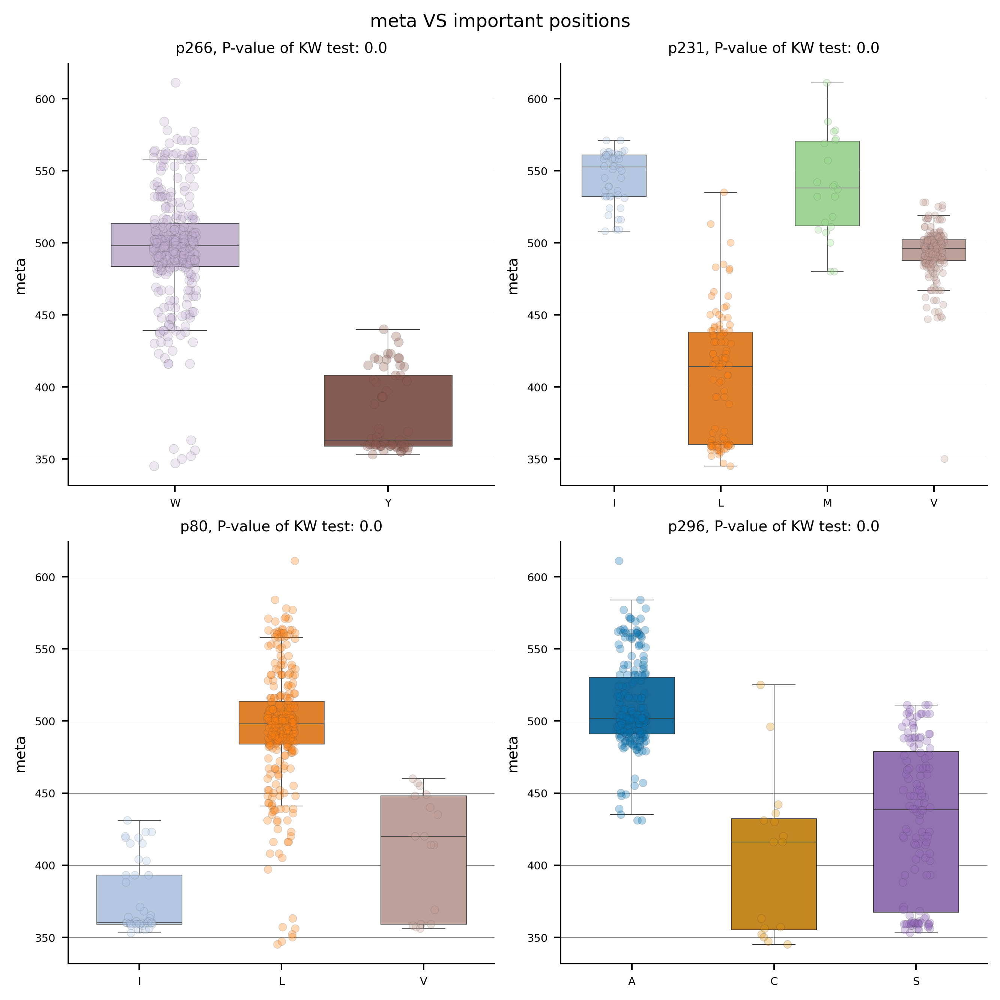

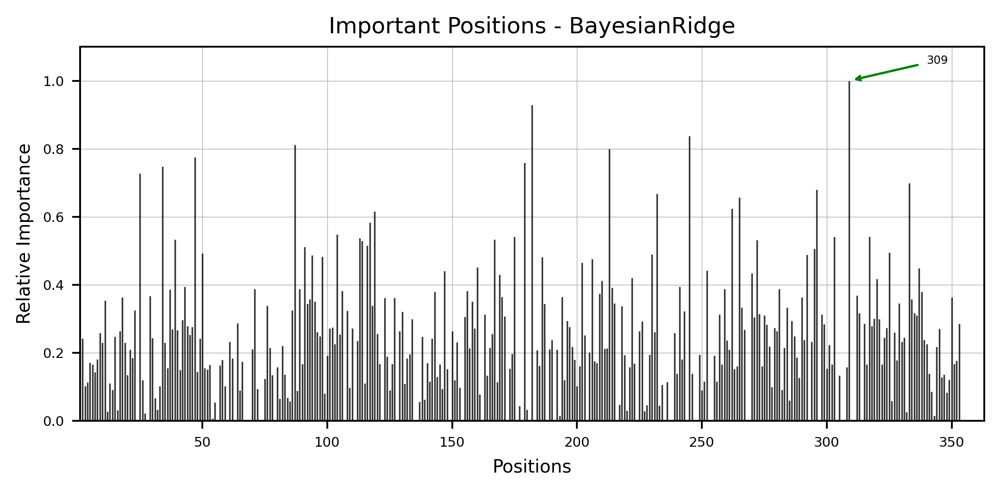

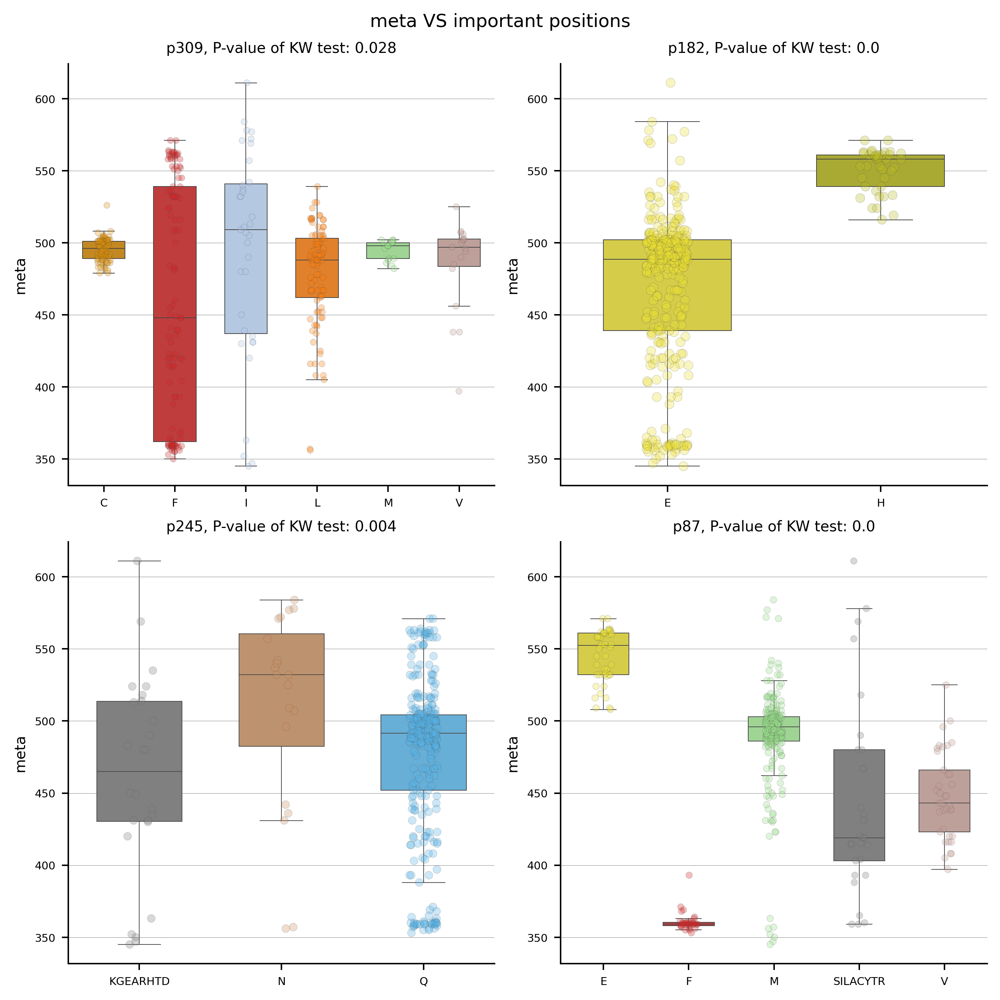

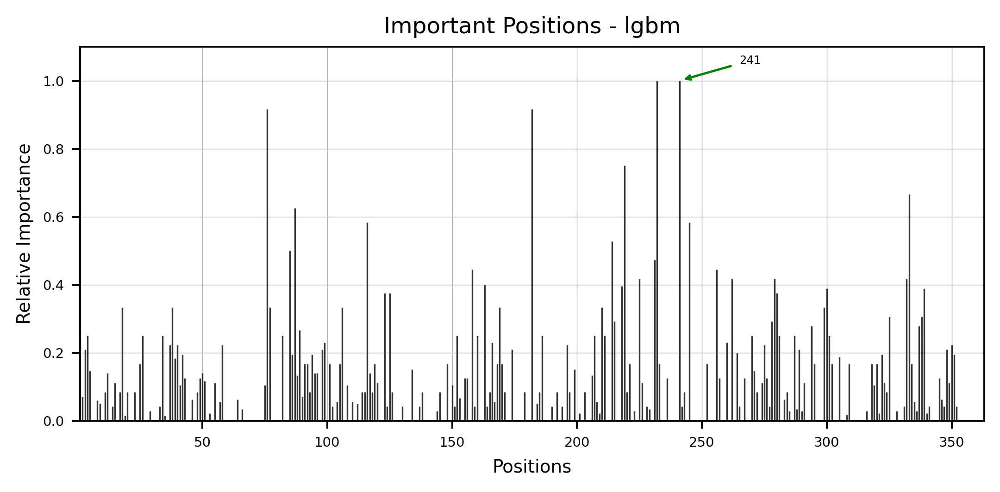

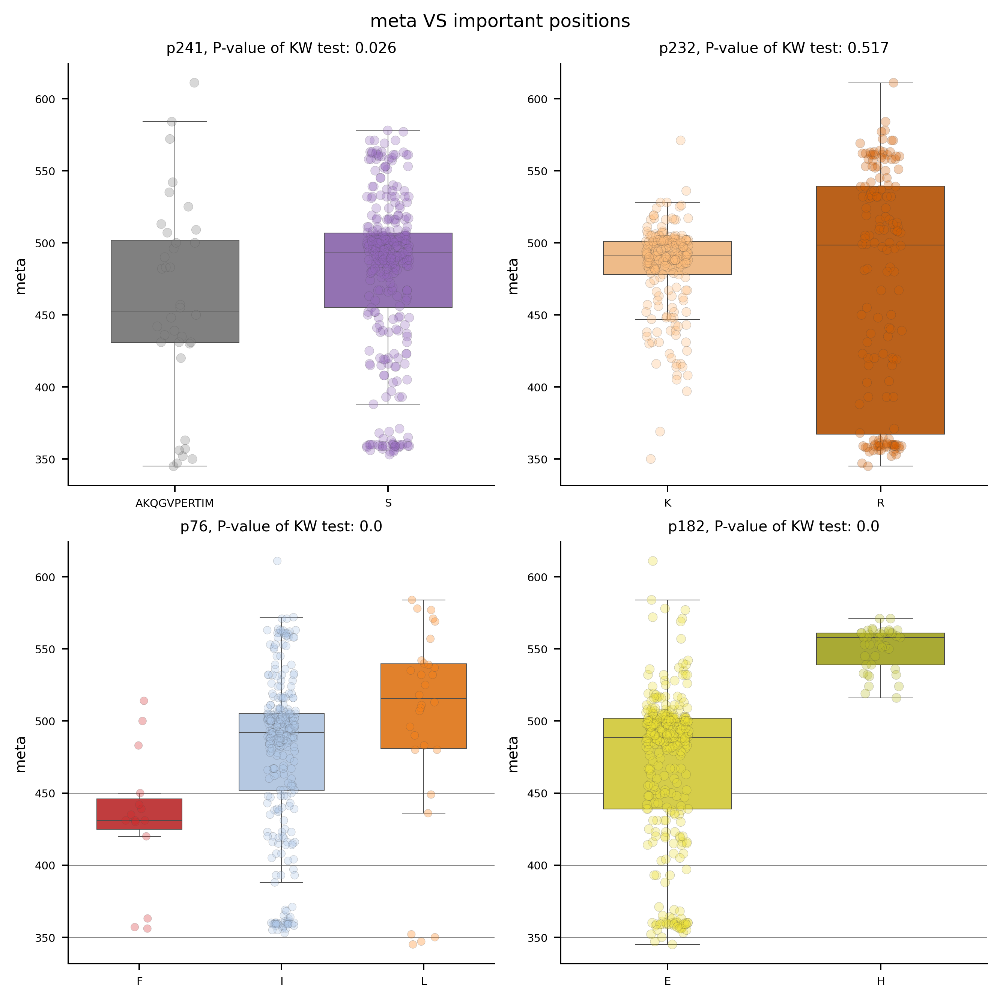

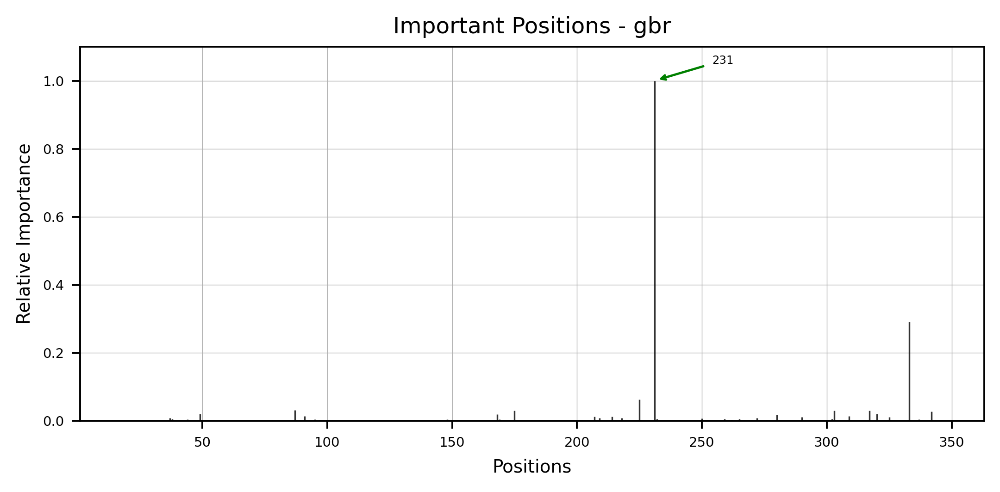

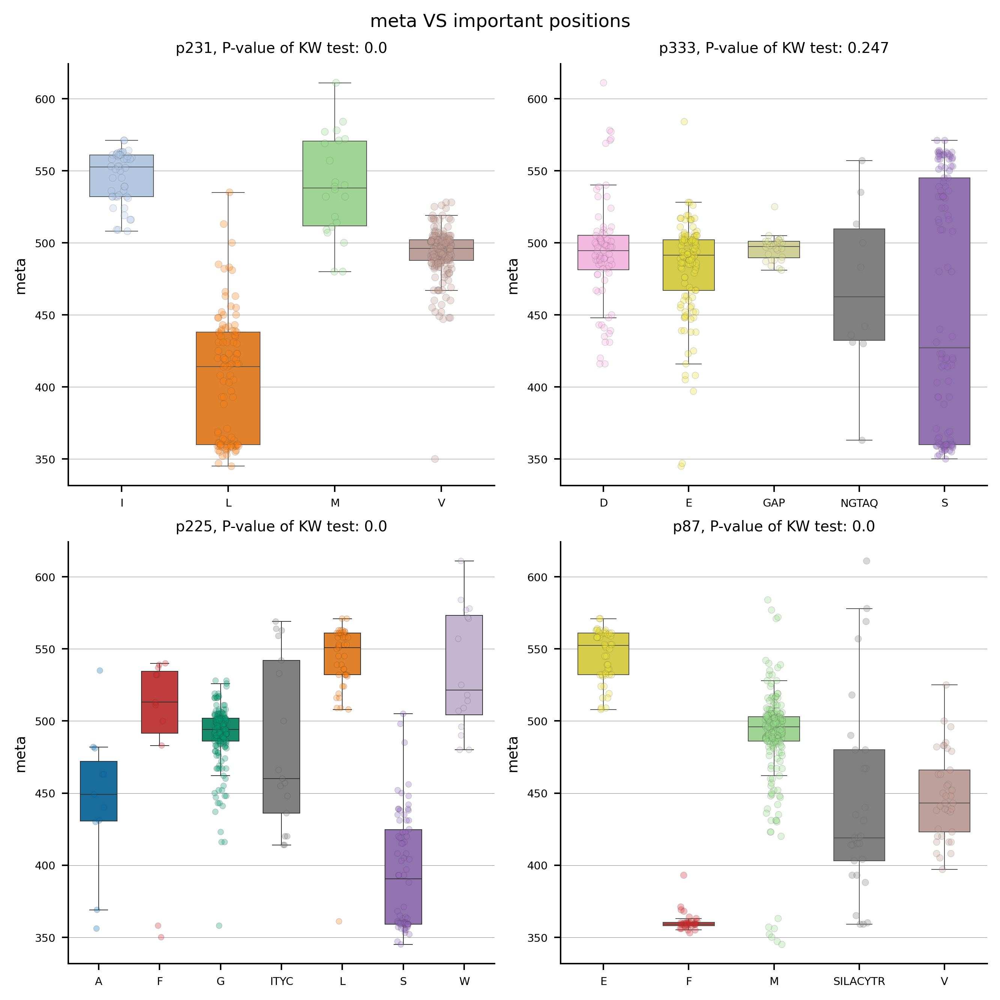

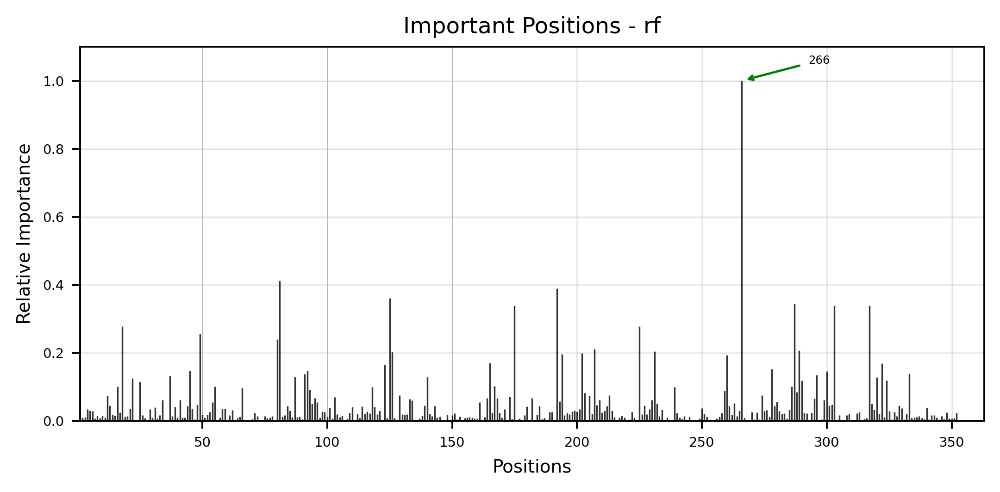

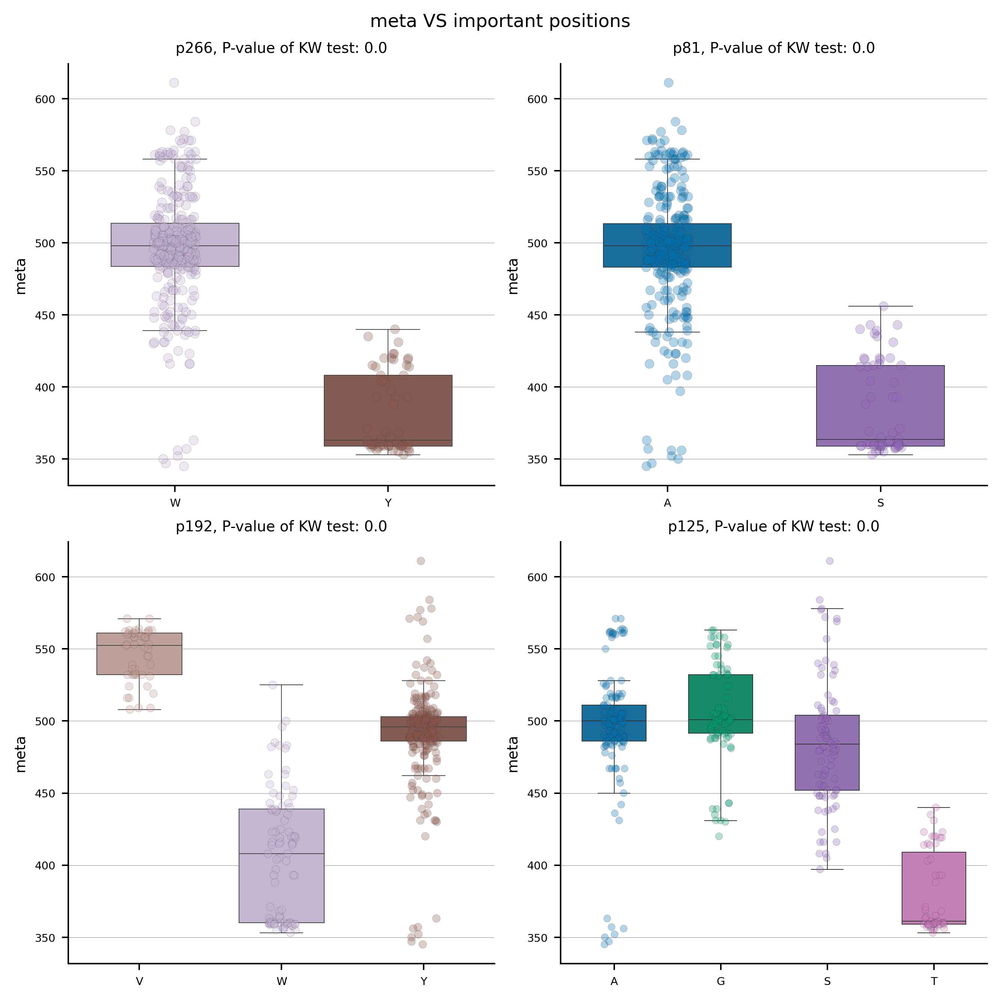

In [83]:
for model in top:
    model_name = model.steps[-1][0]
    dp_plot(importance=importance_from_pipe(model),
            imp_col='standard_value',
            model_name = model_name, report_dir=report_dir)
    
    plot_imp_model(importance=importance_from_pipe(model), 
               X_train=tr, y_train=y, model_name=model_name,
                   meta_var='meta', model_type=ana_type, report_dir=report_dir)

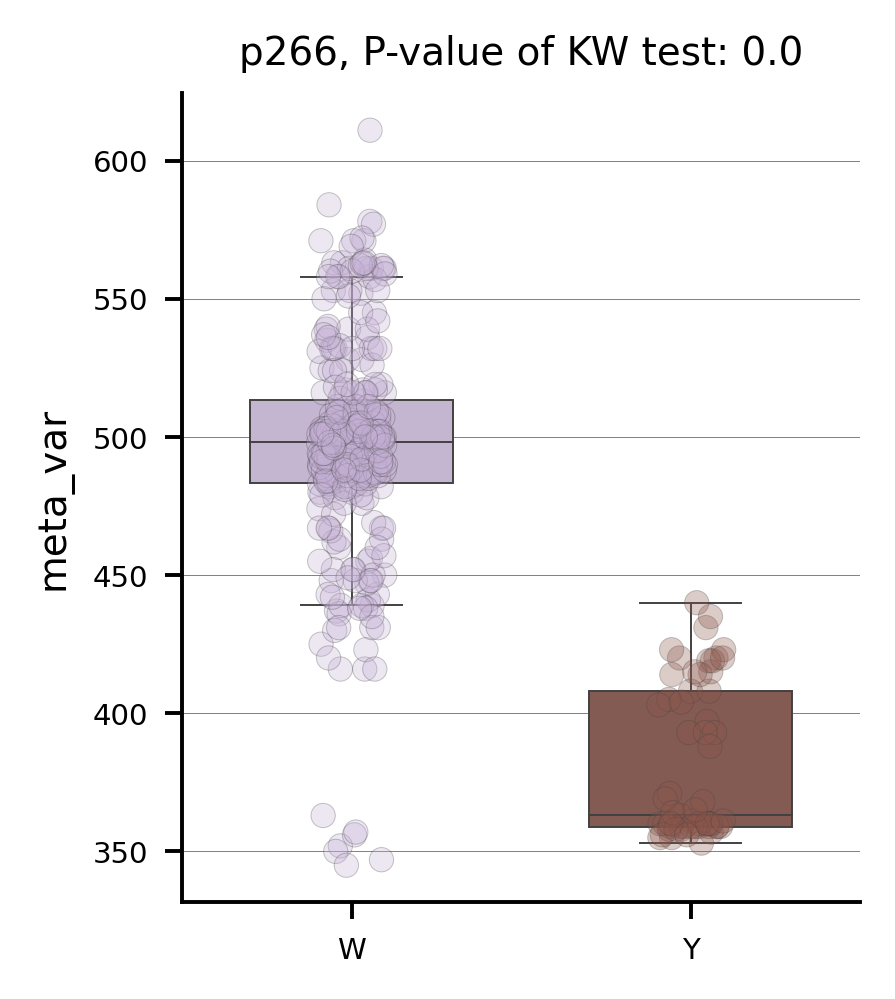

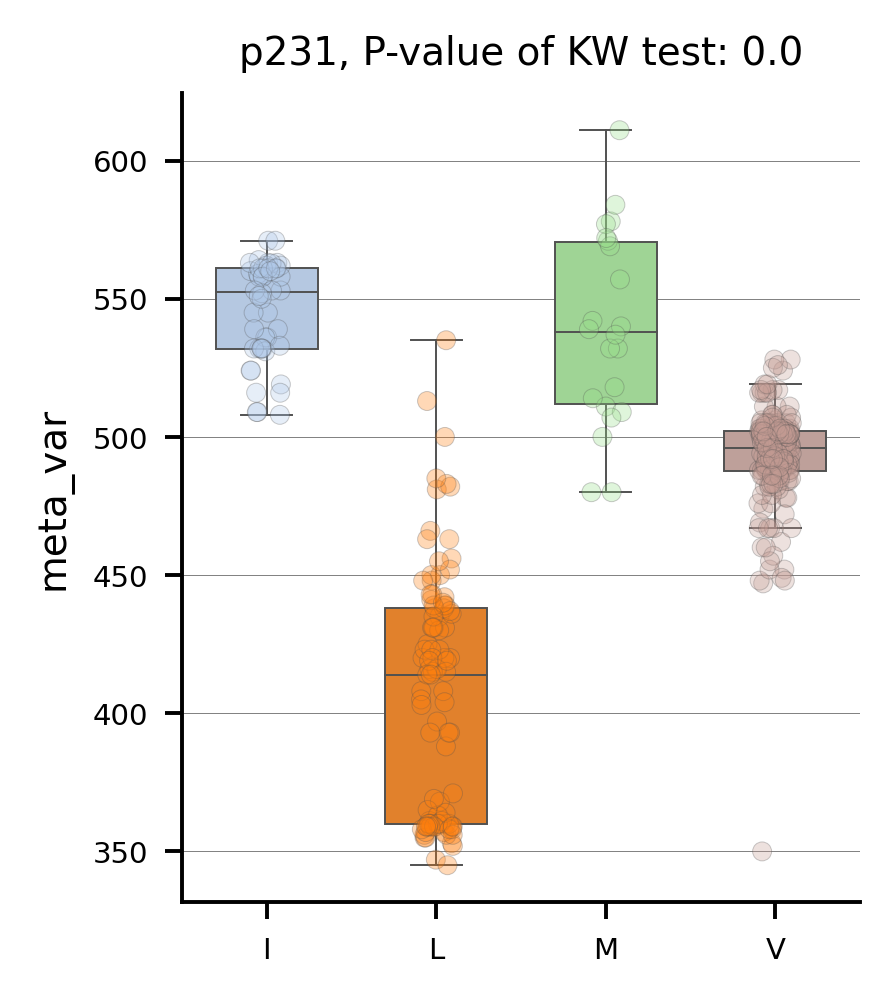

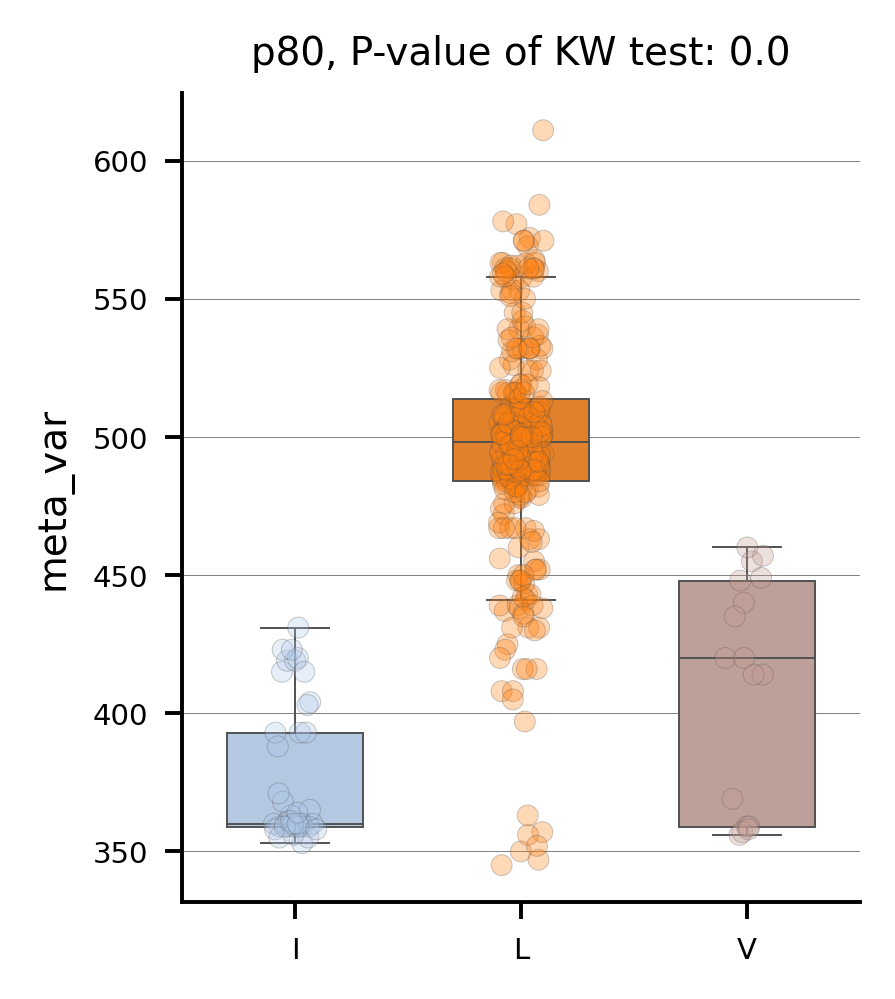

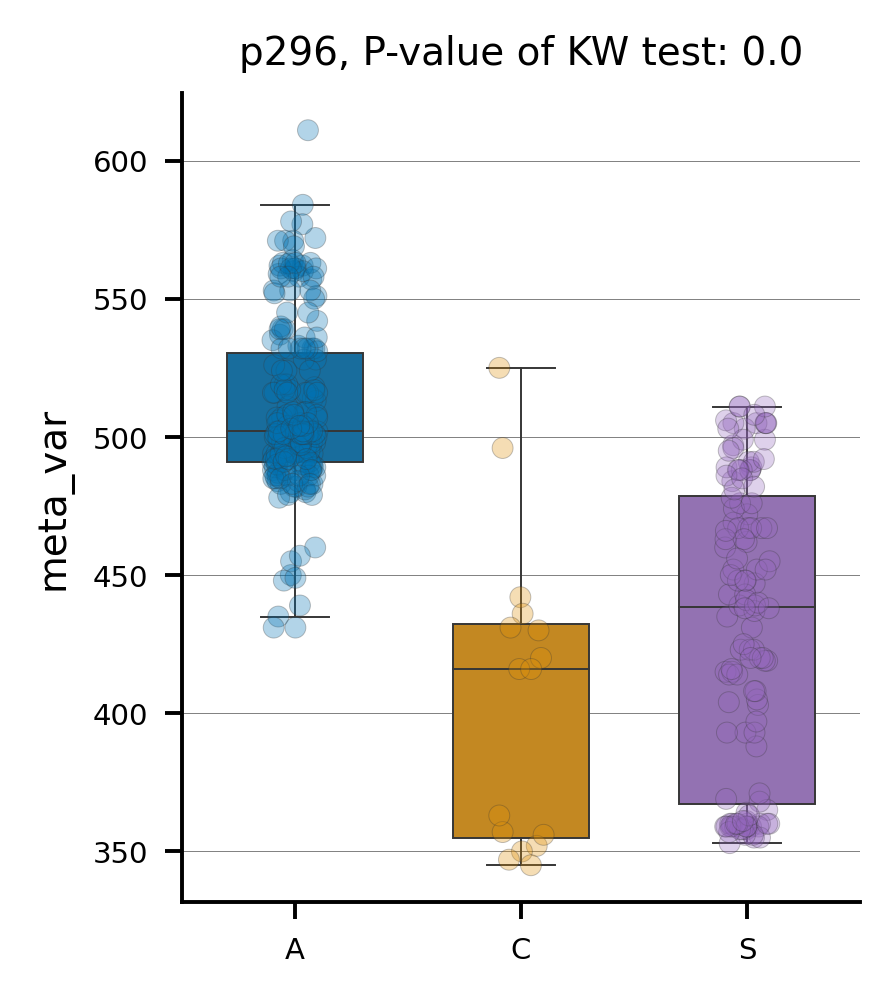

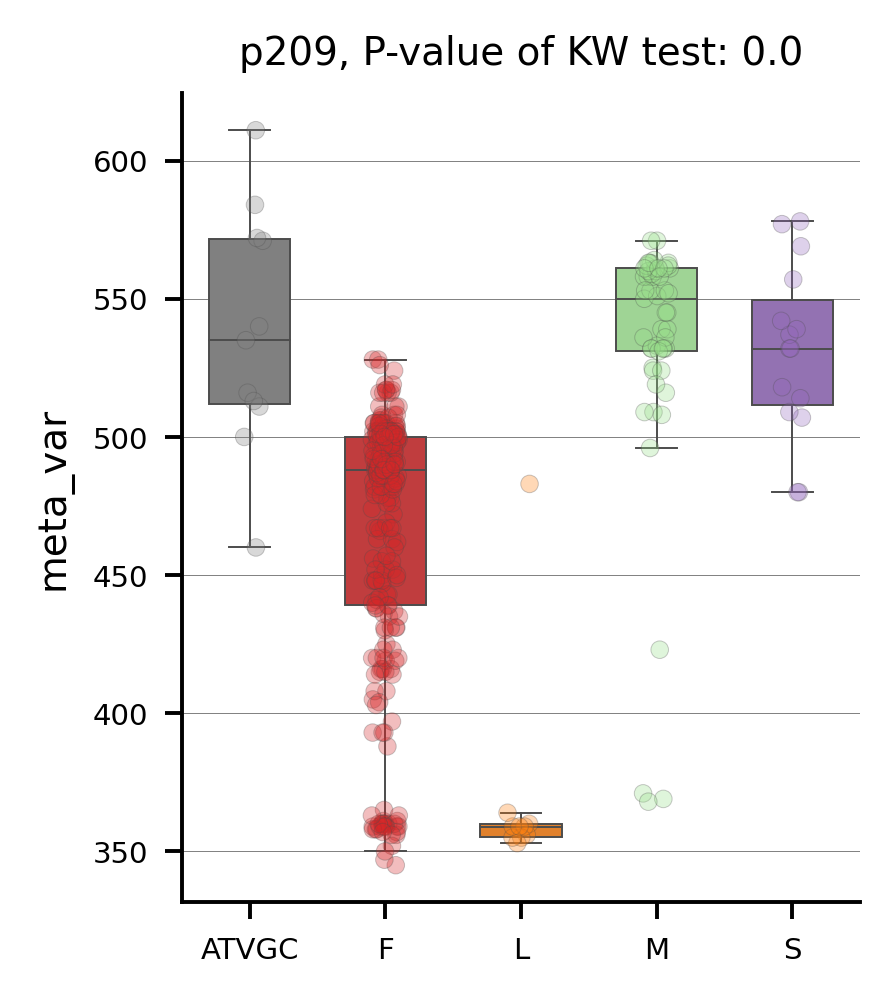

...

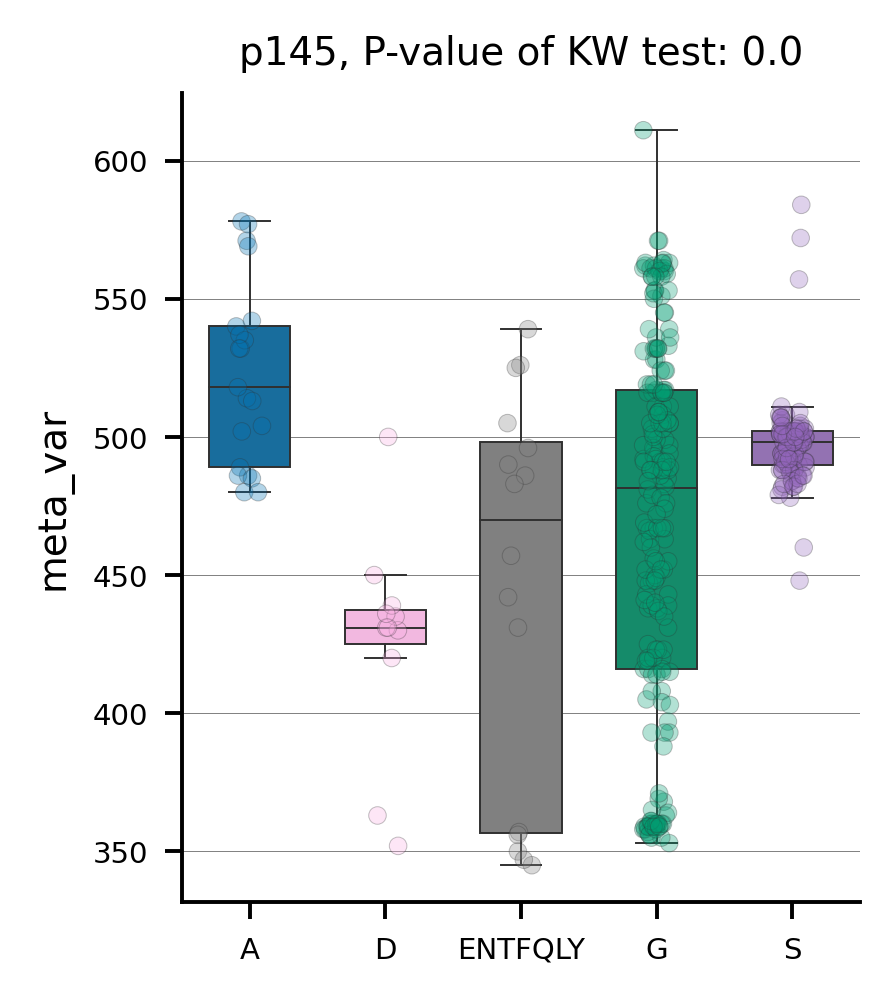

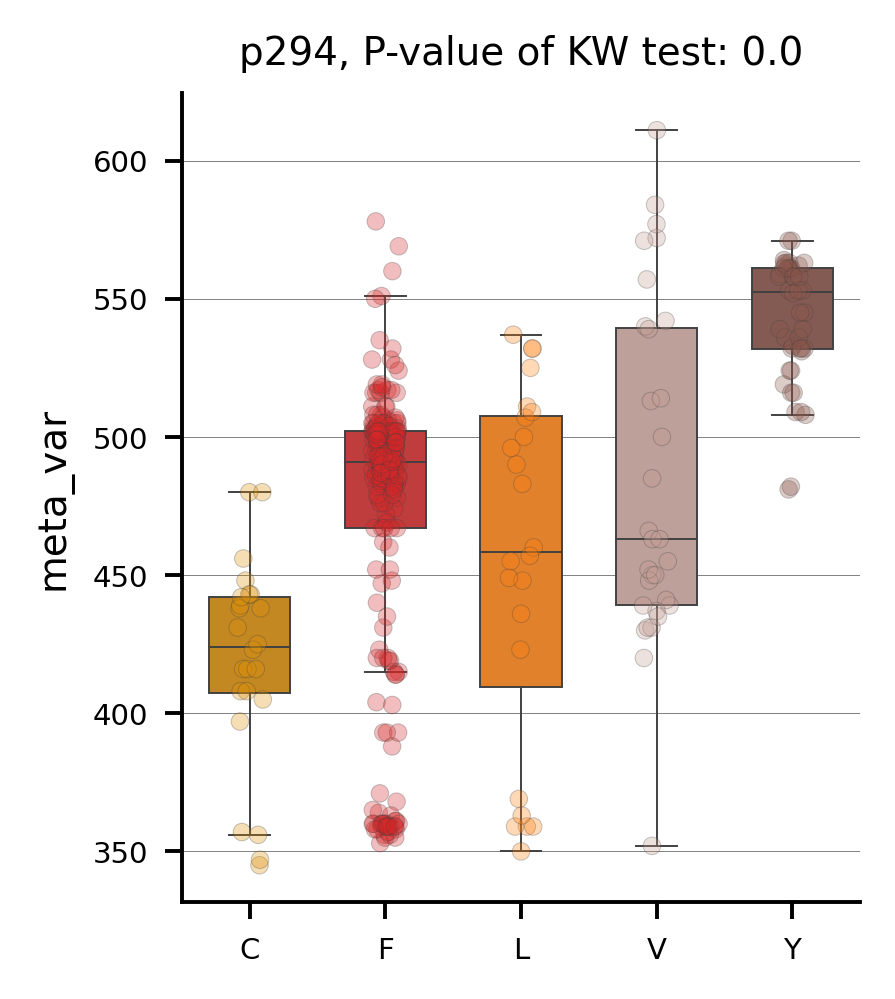

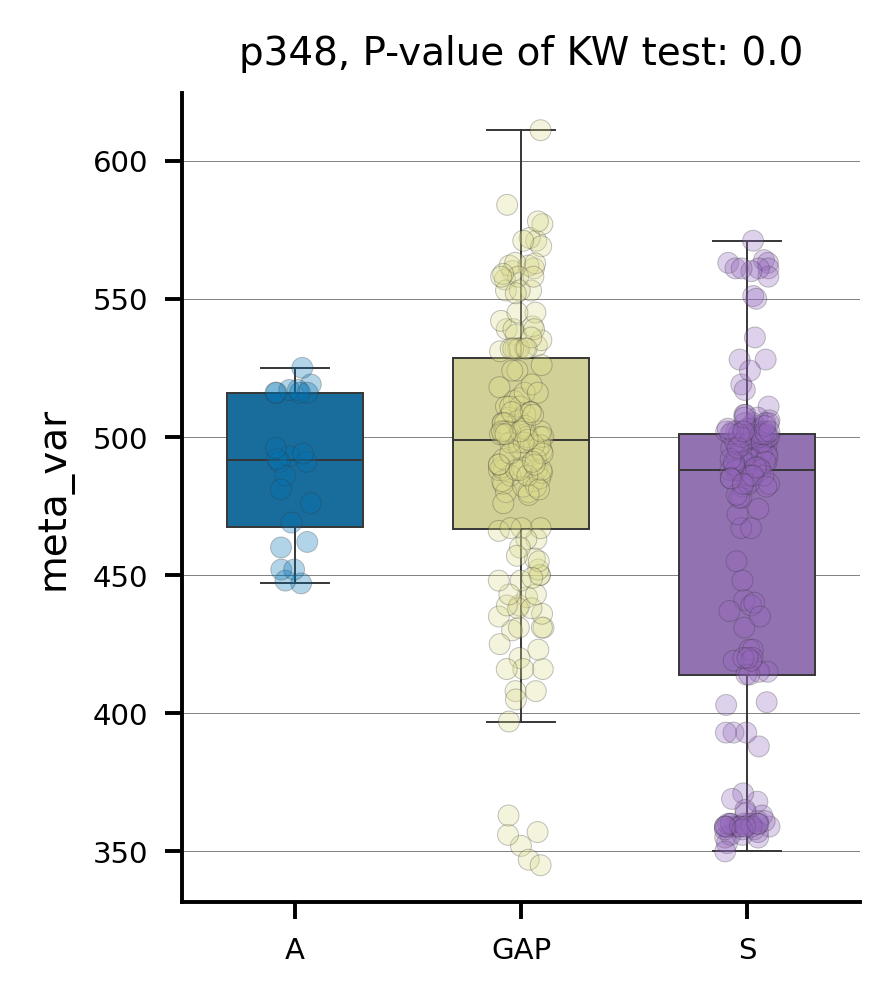

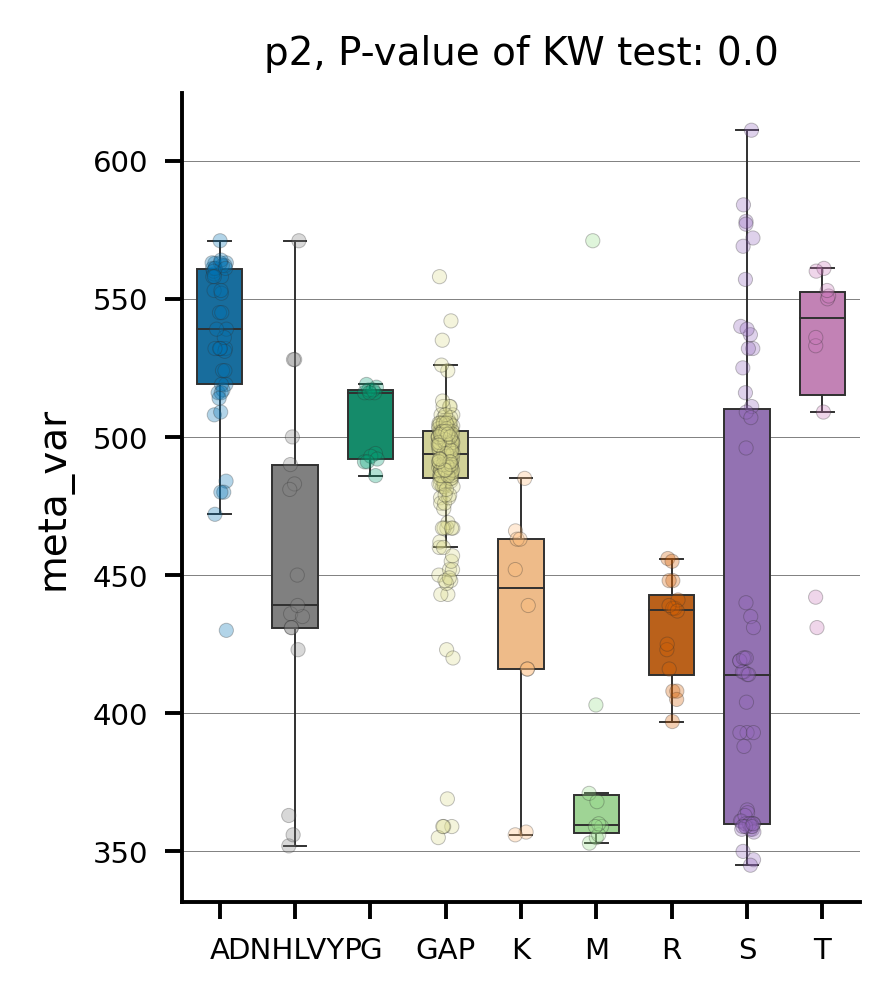

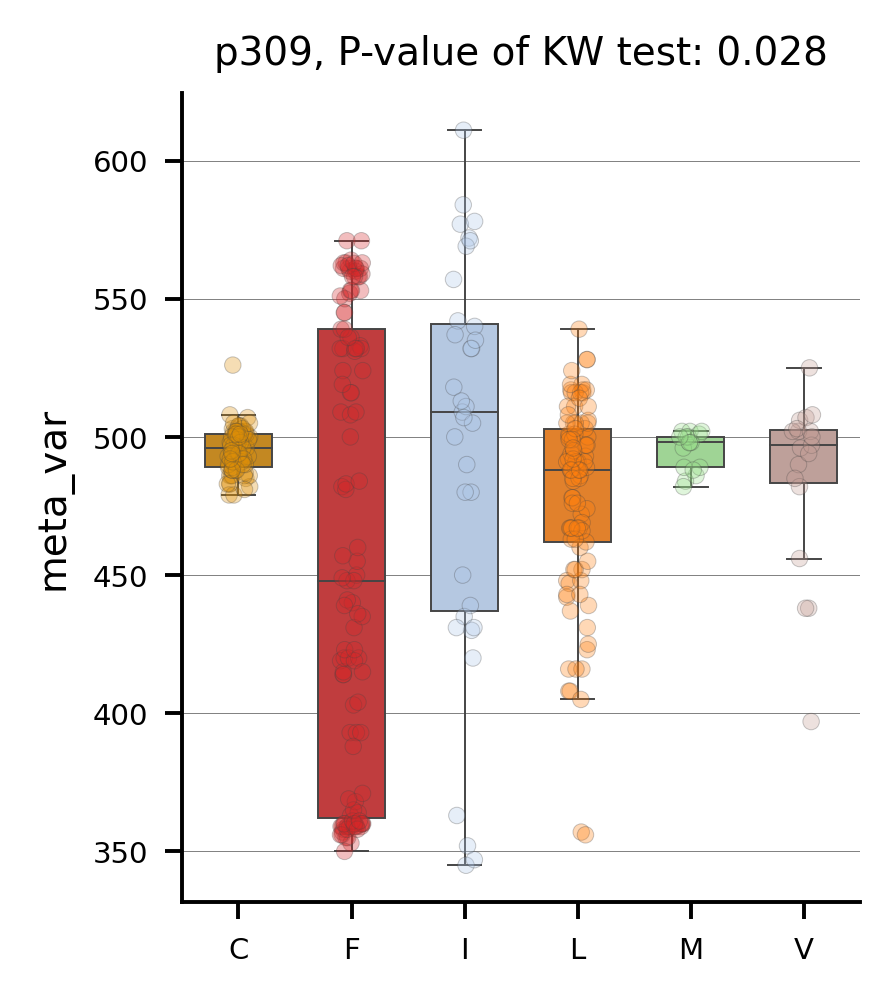

In [84]:
pl = plot_imp_all(final_models=top,
                  X_train=tr, y_train=y,
                  model_type = ana_type,
                  report_dir=report_dir, max_plots=100,
                  figsize=(2.5, 3))

In [85]:
from deepBreaks.utils import load_obj
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error

In [86]:
top_per_mod = report_dir + '/' + mtml[0] + '.pkl'
load_top_mod = load_obj(top_per_mod)

In [87]:
print(f'Here is a list of your top performing models to test...\n{mtml}')

Here is a list of your top performing models to test...
['xgb', 'BayesianRidge', 'lgbm', 'gbr', 'rf']


# <font color=red>STEP 4: Translate Candidate STSs</font> 
## This section is used to translate candidate STSs to the bovine or squid equivalent.
### The bovine and squid sequence dataframes that were saved earlier and are called again here


In [88]:
import pandas as pd
import os

In [89]:
#STEP 4: Translate Candidate STSs 
#translate candidate STSs to the bovine or squid equivalent 
#bovine and squid sequence dataframes were saved earlier and are called again here
m = 0
tm = ''
k=0
gaps=0
#import importance_report.csv from report_dir
true_pos = []
aa = []
tmd = []
df = pd.read_csv(f'{report_dir}\importance_report.csv')
#take the list of important sites and translate them to the bovine standard equivalent, 
#we do this by taking the site number and subtracting the number of '-' between the start of the sequence and the desired site. 
for rows in reference_seq.values:  
    rows = str(rows)
    #print(rows)
    if rows == 'nan':
    #We want to write the 'true_pos', 'aa', and 'TMD' to the 'importance_report' csv file
        gaps += 1
        k += 1
        true_pos.append('NA')
        aa.append('-')
        tmd.append('NA')
    else:
        #print("The number of gaps is " + str(gaps))
        k+=1
        trans_site = k - gaps
        if ref_seq_name == 'bovine':
            if trans_site in range(3,37):
                tm = 'N-Termina'
            elif trans_site in range(37,62):
                tm = '1'
            elif trans_site in range(74,96):
                tm = '2'
            elif trans_site in range(111,133):
                tm = '3'
            elif trans_site in range(153,174):
                tm = '4'
            elif trans_site in range(203,225):
                tm = '5'
            elif trans_site in range(253,275):
                tm = '6'
            elif trans_site in range(287,309):
                tm = '7'
            else:
                tm = 'CT/EC'
        else:
            if trans_site in range(3,34):
                tm = 'N-Termina'
            elif trans_site in range(34,59):
                tm = '1'
            elif trans_site in range(71,97):
                tm = '2'
            elif trans_site in range(110,132):
                tm = '3'
            elif trans_site in range(152,173):
                tm = '4'
            elif trans_site in range(200,225):
                tm = '5'
            elif trans_site in range(262,284):
                tm = '6'
            elif trans_site in range(294,315):
                tm = '7'
            else:
                tm = 'CT/EC'                
        
        true_pos.append(str(trans_site))
        aa.append(rows)
        tmd.append(tm)
true_pos.pop()
aa.pop()
tmd.pop()

df['true_position'] = true_pos
df['TMD'] = tmd
df['amino_acid'] = aa
df.to_csv(path_or_buf= os.path.join(report_dir,r'importance_report.csv'),index = 'Feature',mode="w")
#df.head()


# <font color=red>STEP 5: Query the Model to Predict NEW Sequences</font> 
## Takes new sequences, inserts them into existing alignment to properly format for model query, then returns prediction of the λmax value for each sequence...

In [90]:
import os
import subprocess
from deepBreaks.utils import load_obj
from deepBreaks.preprocessing import read_data
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
from vpod_scripts.prediction_functions_db import process_sequences_from_file

This is a version of the prediction method which can be used DIRECTLY after model training... 

In [94]:
#path to the mafft.bat file - change to your own directory!
mafft_exe = 'C:/Users/safra/mafft-win/mafft.bat'
#path to sequences we want to add to an existing alignment in FASTA format
input_file = './subtests/supp_test_data/msp_erg_raw.txt'
#name for desired output file
output_file = 'opsin_predictions.tsv'
#path to target/selected model
selected_model = report_dir + '/' + mtml[0] + '.pkl'
#function for querying model - this will take care of creating an output file for you.
process_sequences_from_file(mafft_exe,input_file,output_file,selected_model,seqFileName, gap_threshold=0.51)


Processing predictions...
Neogonodactylus_oerstedii|334	445.09241524351773

Neogonodactylus_oerstedii|383	462.3950896676752

Bombus_impatiens|539	540.2379545980301

Bombus_impatiens|424	428.0946833689541

Bombus_impatiens|347	372.29786822426956

Drosophilia_melanogaster|486	477.546944113717

Drosophilia_melanogaster|418	511.73482980502143

Drosophilia_melanogaster|331	361.44679178024296

Drosophilia_melanogaster|355	381.73441187364085

Drosophilia_melanogaster|442	431.47419070244985

Drosophilia_melanogaster|515	517.5854870531722

Lycaena_rubidus|360	352.3293617119954

Lycaena_rubidus|437	420.2890951520932

Lycaena_rubidus|500	483.2735654572339

Lycaena_rubidus|568	557.6138874609685

Hemigrapsus_sanguineus|480	505.9520726719816

Schistocerca_gregaria|441	467.4142214792372

Schistocerca_gregaria|514	510.97429433430165

Schistocerca_gregaria|339	364.9475816692077

Gryllus_bimaculatus|515	523.2127923053772

Gryllus_bimaculatus|445	399.6343729338795

Gryllus_bimaculatus|332	375.96259405080

This is a version of the prediction method which can be used to ACCESS EXISTING MODELS in a SEPERATE SESSION after model training... 

In [ ]:
#path to the mafft.bat file - change to your own directory!
mafft_exe = 'C:/Users/safra/mafft-win/mafft.bat'
#path to sequences we want to add to an existing alignment in FASTA format
input_file = './subtests/supp_test_data/msp_erg_raw.txt'
#name for desired output file
output_file = 'opsin_predictions.tsv'
#path to the primary alignment used for training the model - if trying access a specific file later
path = 'c:/Users/safra/Documents/GitHub/visual-physiology-opsin-db/vpod_data/VPOD_1.0/formatted_data_subsets/vpod_2023-10-16_12-13-11'
seqFileName = f'{path}/VPOD_wds_het_1.0.fasta' 
#path to target/selected model
#can use method below or enter path manually if coming back to notebook with no variables intialized
report_dir ='C:/Users/safra/Documents/GitHub/visual-physiology-opsin-db/result_files/main_model_results/mafft/wds_model_2023-10-16_12-13-40'
selected_model = report_dir + '/gbc.pkl'
#function for querying model - this will take care of creating an output file for you.
process_sequences_from_file(mafft_exe,input_file,output_file,selected_model,seqFileName)

